# Pogled na podatke nakon čišćenja i transformacija

In [20]:
import numpy as np
import pandas as pd
from geopy.distance import geodesic
import numpy as np
import matplotlib.pyplot as plt
from shapely import Point
import geopandas as gpd
import warnings

warnings.filterwarnings('ignore')

In [21]:
df = pd.read_csv('dataset/transformed_deliverytime.csv')
df.head()

,Unnamed: 0,ID,Delivery_person_ID,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Weatherconditions,...,Vehicle_condition,Type_of_order,Type_of_vehicle,multiple_deliveries,Festival,City,Time_taken(min),Datetime_Ordered,Datetime_Picked,distance(km)
0,0,0x4607,INDORES13DEL02,37,4.9,22.745049,75.892471,22.765049,75.912471,Sunny,...,2,snack,motorcycle,0,0,Urban,24,2022-03-19 11:30:00,2022-03-19 11:45:00,3.020737
1,1,0xb379,BANGRES18DEL02,34,4.5,12.913041,77.683237,13.043041,77.813237,Stormy,...,2,snack,scooter,1,0,Metropolitian,33,2022-03-25 19:45:00,2022-03-25 19:50:00,20.143737
2,2,0x5d6d,BANGRES19DEL01,23,4.4,12.914264,77.678400,12.924264,77.688400,Sandstorms,...,0,drinks,motorcycle,1,0,Urban,26,2022-03-19 08:30:00,2022-03-19 08:45:00,1.549693
3,3,0x7a6a,COIMBRES13DEL02,38,4.7,11.003669,76.976494,11.053669,77.026494,Sunny,...,0,buffet,motorcycle,1,0,Metropolitian,21,2022-04-05 18:00:00,2022-04-05 18:10:00,7.774497
4,4,0x70a2,CHENRES12DEL01,32,4.6,12.972793,80.249982,13.012793,80.289982,Cloudy,...,1,snack,scooter,1,0,Metropolitian,30,2022-03-26 13:30:00,2022-03-26 13:45:00,6.197898


In [22]:
def df_to_gdf(df, lat_col_name, long_col_name):
    gdf = gpd.GeoDataFrame( 
        geometry=gpd.points_from_xy(df[long_col_name], df[lat_col_name]), 
        crs="EPSG:4326"
    )

    return gdf

## Pregled lokacija restorana 

In [23]:
restaurant_gdf = df_to_gdf(df, 'Restaurant_latitude', 'Restaurant_longitude')
restaurant_gdf.explore()

## Pregled lokacija dostave

In [24]:
delivery_gdf = df_to_gdf(df, 'Delivery_location_latitude', 'Delivery_location_longitude')
delivery_gdf.explore()

## Pregled udaljenosti i vremena dostave

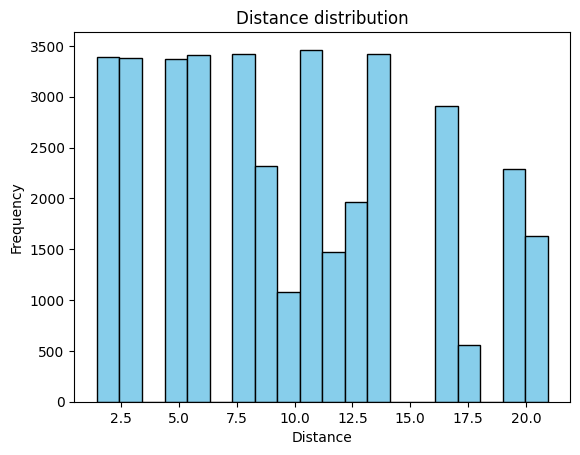

In [25]:
distance_data = df['distance(km)']

plt.hist(distance_data, bins=20, color='skyblue', edgecolor='black')

plt.xlabel('Distance')
plt.ylabel('Frequency')
plt.title('Distance distribution')

plt.show()

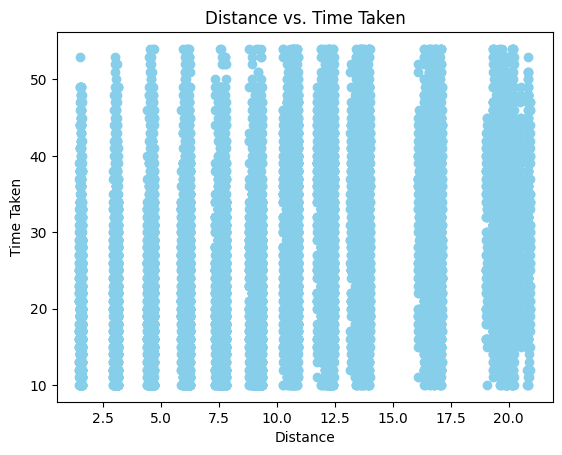

In [26]:
time_taken_data = df['Time_taken(min)']

plt.scatter(distance_data, time_taken_data, color='skyblue', marker='o')

plt.xlabel('Distance')
plt.ylabel('Time Taken')
plt.title('Distance vs. Time Taken')

plt.show()

In [27]:
from scipy.stats import pearsonr

correlation = pearsonr(distance_data, time_taken_data)[0]
print(f"Pearson Correlation: {correlation:.2f} ")

Pearson Correlation: 0.32 
